In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import os
import pickle
#run pip3 install pyqt5 on OSX
#%matplotlib qt
%matplotlib inline
#get_ipython().magic('matplotlib inline')


In [2]:
#globals
camera_path="camera_cal/"
test_images_path="test_images/"
chessboard_size=(9,6)

In [3]:
def print_2images(image1,image2,title1='',title2=''):
    plt.clf()
    f=plt.figure(figsize=(20,200))
    f.tight_layout()
    ax=plt.subplot(1,2,1)
    ax.imshow(image1,cmap="gray")
    ax.set_title(title1,fontsize=30)
    ax=plt.subplot(1,2,2)
    ax.imshow(image2,cmap='gray')
    ax.set_title(title2,fontsize=30)
    plt.show()
    
def print_3images(image1,image2,image3):
    plt.clf()
    f=plt.figure(figsize=(20,200))
    f.tight_layout()
    ax=plt.subplot(1,3,1)
    ax.imshow(image1,cmap="gray")
    ax=plt.subplot(1,3,2)
    plt.imshow(image2,cmap='gray')
    ax=plt.subplot(1,3,3)
    plt.imshow(image3,cmap='gray')
    plt.show()

# Camera Calibration

Note: If you are reading in an image using mpimg.imread() this will read in an RGB image 
    and you should convert to grayscale using cv2.COLOR_RGB2GRAY, but if you are using cv2.imread() 
    or the glob API, as happens in this video example, 
    this will read in a BGR image and you should convert to grayscale using cv2.COLOR_BGR2GRAY.

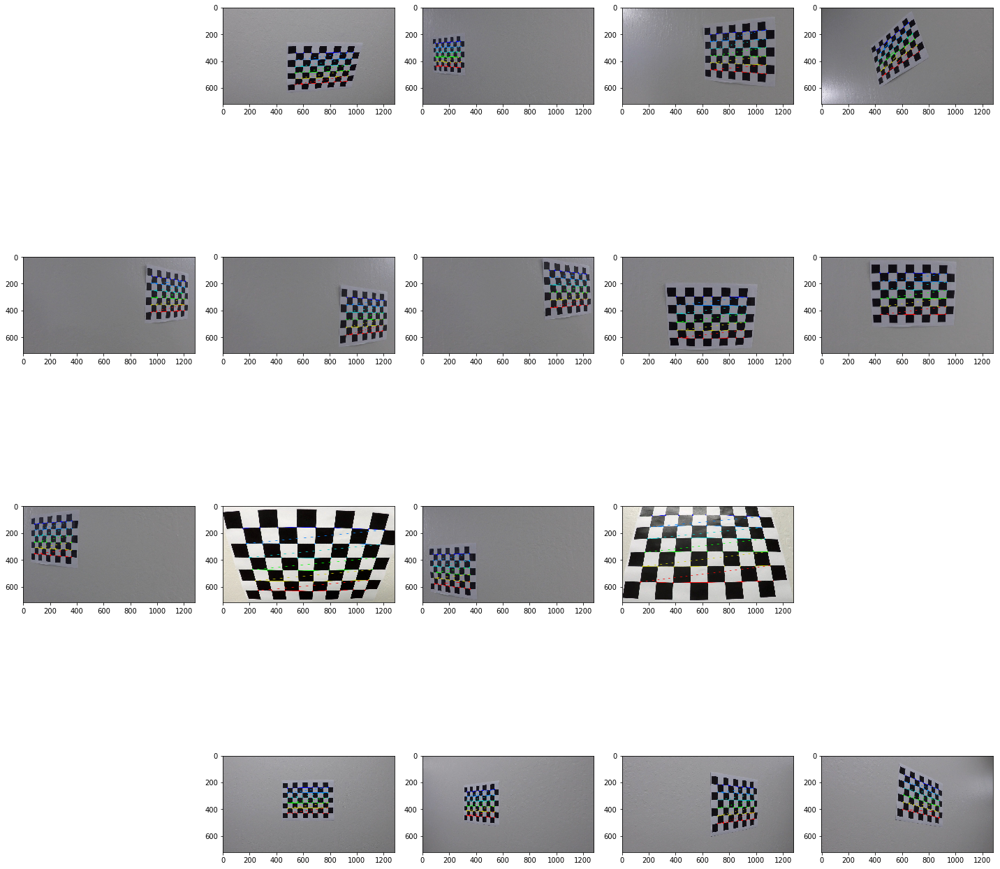

Couldnt find a 9x6 chess board in these images:
['calibration1.jpg', 'calibration4.jpg', 'calibration5.jpg']


In [4]:
#import chessboard images 
#files that have a 9x6 chessboard and will be used for calibration
file_list=[]
#files that dont have a 9x6 chessboard
ignore_list=[]
f=plt.figure(figsize=(20,20))
objpoints= []
imgpoints= []
#object points of a 9x6 chess board (0,0,0)((1,0,0)(2,0,0)....(8,5,0)
objp = np.zeros((6*9,3),np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
path_prefix=camera_path
i=0
for filename in os.listdir(path_prefix):
    i=i+1
    input_img = mpimg.imread(path_prefix+filename)
    gray = cv2.cvtColor(input_img,cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, chessboard_size, None)
    if ret == True:
        file_list.append(filename)
        imgpoints.append(corners)
        objpoints.append(objp)
        img = cv2.drawChessboardCorners(input_img, chessboard_size, corners, ret)
        f.tight_layout()
        ax=plt.subplot(4,5,i)
        ax.imshow(img,cmap="gray")
    else:
        ignore_list.append(filename)
plt.show()
print("Couldnt find a 9x6 chess board in these images:")
print (ignore_list)


In [5]:
#this removes distortion from a given image 
def undistort(image):
    cam=pickle.load(open("camera.p","rb"))
    loaded_mtx=cam["mtx"]
    loaded_dist=cam["dist"]
    dst = cv2.undistort(image, loaded_mtx, loaded_dist, None, loaded_mtx)  
    return dst

#this reads a image file from the given filename and then returns an undistorted image
def read_image(filename):
    #with path prefix attached
    img = mpimg.imread(filename)
    #read in RGB
    dst = undistort(img)
    return dst

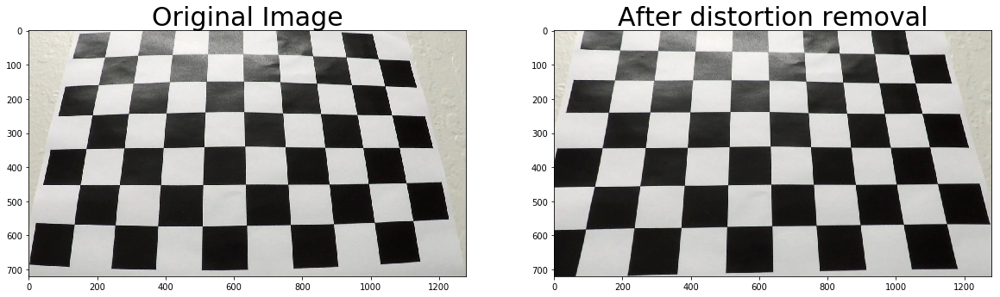

In [6]:
plt.clf()
f=plt.figure(figsize=(20,200))
img = mpimg.imread(path_prefix+"calibration3.jpg")
###gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (img.shape[1],img.shape[0]), None, None)
camera_dist_pickle={}
camera_dist_pickle["mtx"]=mtx
camera_dist_pickle["dist"]=dist
pickle.dump(camera_dist_pickle,open("camera.p","wb"))

dst=undistort(img)
print_2images(img,dst,"Original Image","After distortion removal")

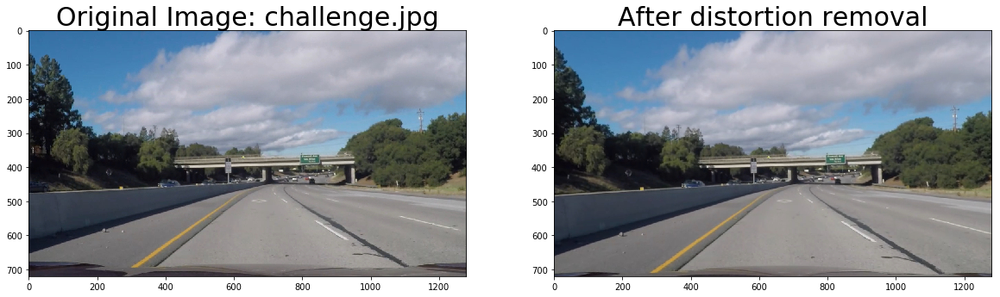

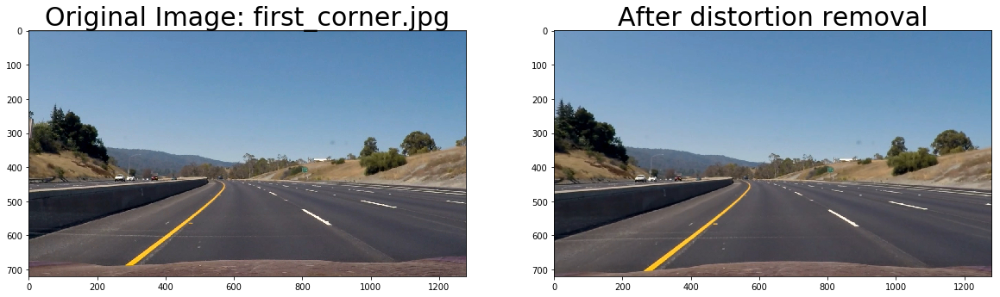

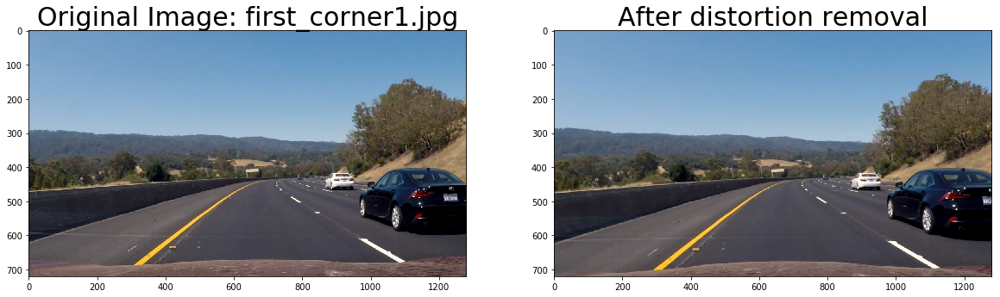

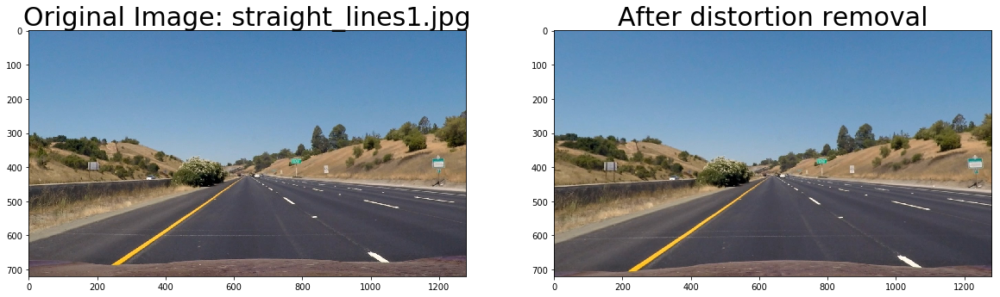

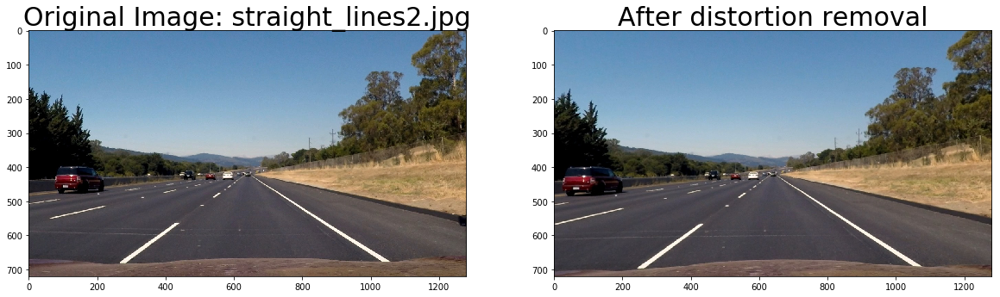

...

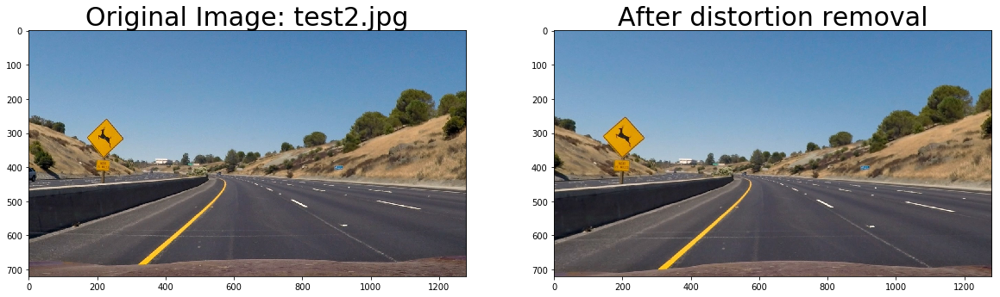

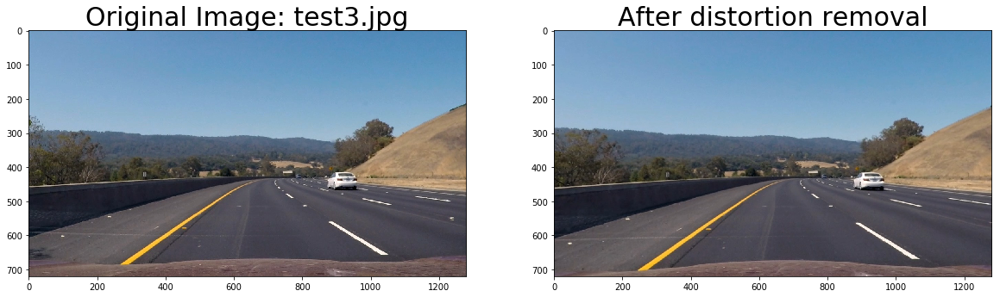

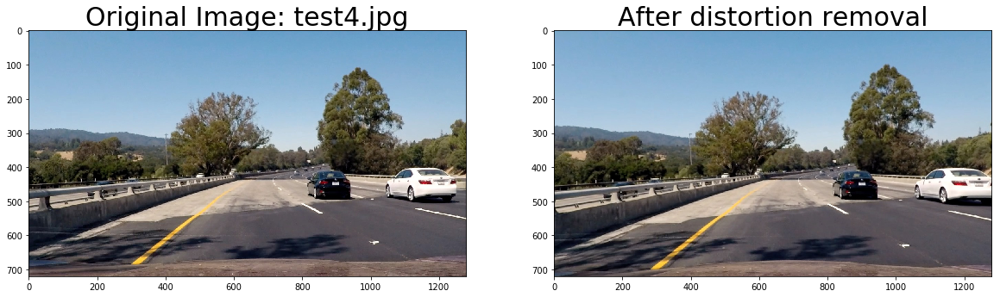

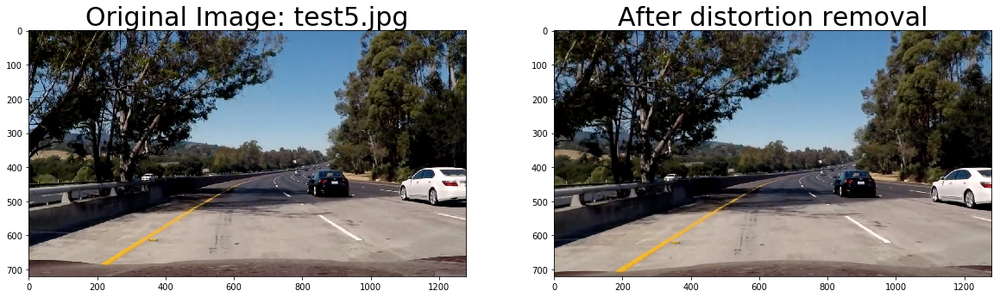

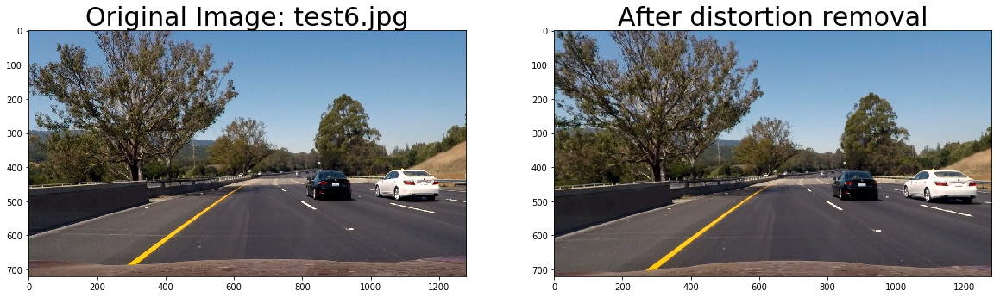

In [7]:
path_prefix=test_images_path
for f in os.listdir(path_prefix):
    filename=path_prefix+f
    img = mpimg.imread(filename)
    dst=read_image(filename)
    print_2images(img,dst,"Original Image: "+f,"After distortion removal")

In [8]:
##Didn't use these in the final pipeline


def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    # Apply threshold
    #### RGB ??BGR ????
    gray=cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    if orient=='x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobel=np.absolute(sobel)
    grad_binary=np.zeros_like(gray)
    grad_binary[(abs_sobel>=thresh[0])&(abs_sobel<=thresh[1])]=1
    return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    gray=cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    abs_sobelxy=np.power((np.power(sobelx,2)+np.power(sobely,2)),0.5)
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    mag_binary=np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel>mag_thresh[0])&(scaled_sobel<mag_thresh[1])]=1
    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    gray=cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    abs_sobelx=np.absolute(sobelx)
    abs_sobely=np.absolute(sobely)
    angle=np.arctan2(abs_sobely, abs_sobelx)
    dir_binary=np.zeros_like(gray)
    dir_binary[(angle>=thresh[0])&(angle<=thresh[1])]=1
    return dir_binary
def color_threshold(image,thresh=(0,255)):
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= thresh[0]) & (s_channel <= thresh[1])] = 1
    return s_binary

In [9]:
path_prefix="test_images/"
#### This function is not used.
def calc_thresholds1(filename='',image=''):
    if image=='':
        image=read_image(filename)
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=5, thresh=(0, 255))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=5, thresh=(0, 255))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(50, 255))
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0, .1))
    combined = np.zeros_like(dir_binary)
    combined[((mag_binary == 1) & (dir_binary == 1))] = 1
    hue_binary = color_threshold(image,thresh=(150,255))
    color_binary=np.zeros_like(image)
    color_binary = np.dstack(( combined, hue_binary, mag_binary)) * 255
    binary_final=np.zeros_like(dir_binary)
    binary_final=color_binary[:,:,0]|color_binary[:,:,1]|color_binary[:,:,2]
    return binary_final


# Creating binary image using color transform and choosing the thresholds.
# Using sobel and direction or magnitude thresholds wasnt helping much.
def calc_thresholds(filename='',image=''):
    kernel_size=3
    if image=='':
        image=read_image(filename)
    #read into two variables.HSV for finding yellow markers and grayscale for white.    
    image_y=cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    #image_w=cv2.cvtColor(image,cv2.COLOR_RGB2GRAY)
    image_w=image
    #Apply Gaussian blur to the images to reduce noise
    blur_image_y = cv2.GaussianBlur(image_y,(kernel_size, kernel_size),0)
    blur_image_w = cv2.GaussianBlur(image_w,(kernel_size, kernel_size),0)
    
    #Initialize completely black images of the same size
    lane_img_y = np.dstack((image, image, image))*255
    lane_img_w = np.dstack((image, image, image))*255
    
    # set the threshold values for Hue,Saturation and Value for selecting our yellow markers.
    #Hue is easy to select but the other values require some trial and error.
    lower_hsv_y=np.array([15,90,0])
    high_hsv_y=np.array([25,255,255])
    
    #create a mask of where the yellow we are looking can be present
    mask_img_y = cv2.inRange(blur_image_y,lower_hsv_y ,high_hsv_y )
    
    #Apply that to the initial size corrected image and get a resulting image.
    result_y=cv2.bitwise_and(image, image, mask = mask_img_y)
    
    #set the threshold for white.
    lower_hsv_w=np.array([200,200,200])
    high_hsv_w=np.array([255,255,255])
    
    #create a mask of where the white we are looking can be present
    mask_img_w = cv2.inRange(blur_image_w,lower_hsv_w ,high_hsv_w )
   
    #Apply that to the initial size corrected image and get a resutling image
    result_w=cv2.bitwise_and(image, image, mask = mask_img_w)
    
    binary=np.zeros_like(image[:,:0])
    binary=result_w[:,:,0]|result_w[:,:,1]|result_w[:,:,2]|result_y[:,:,0]|result_y[:,:,1]|result_y[:,:,2]
    #print_2images(image,binary)
    return binary

## Generate binary images for all test images

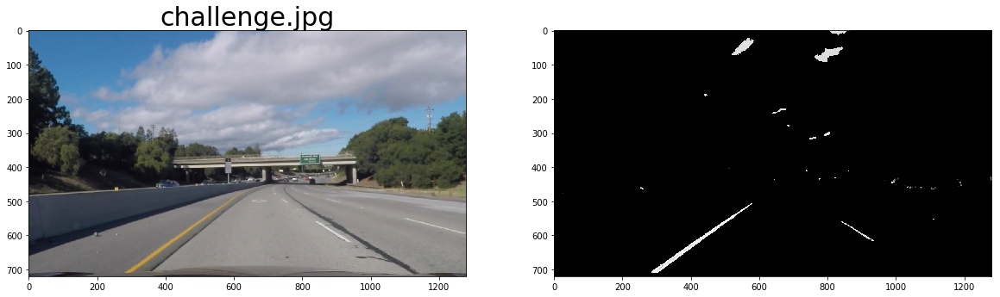

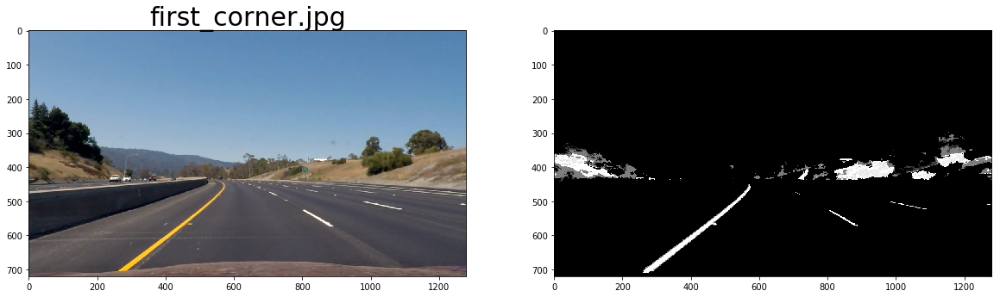

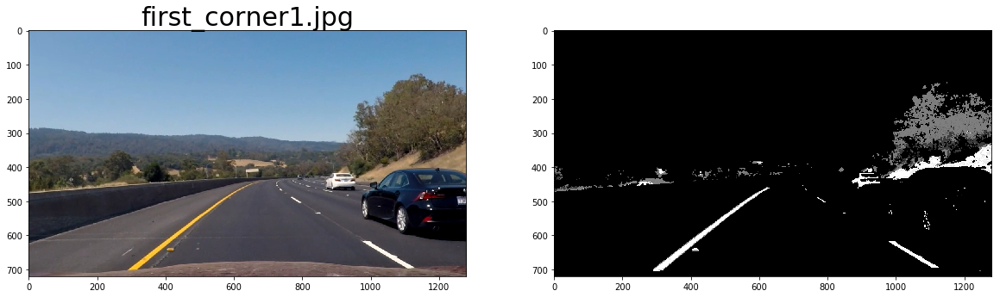

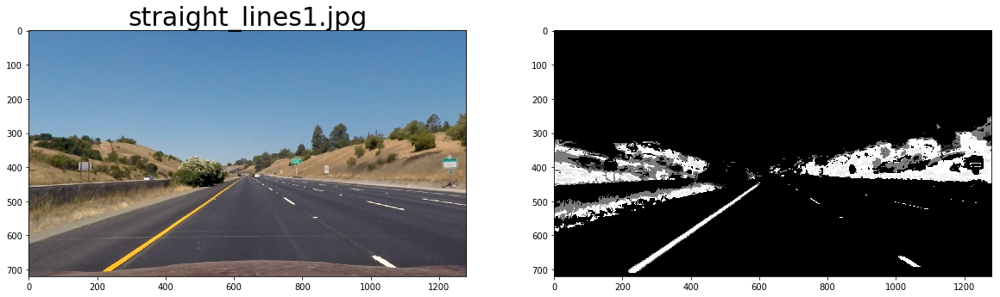

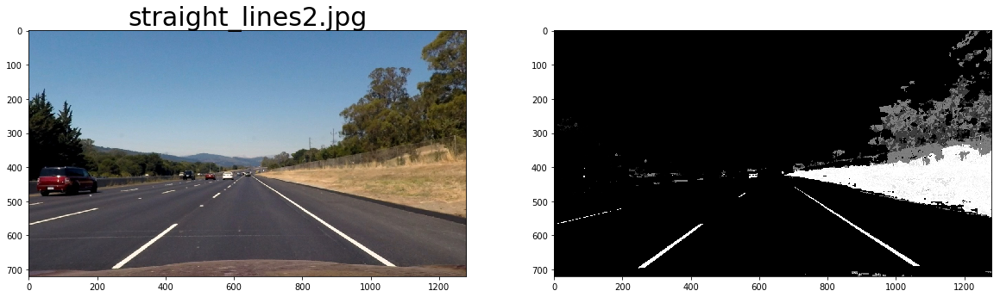

...

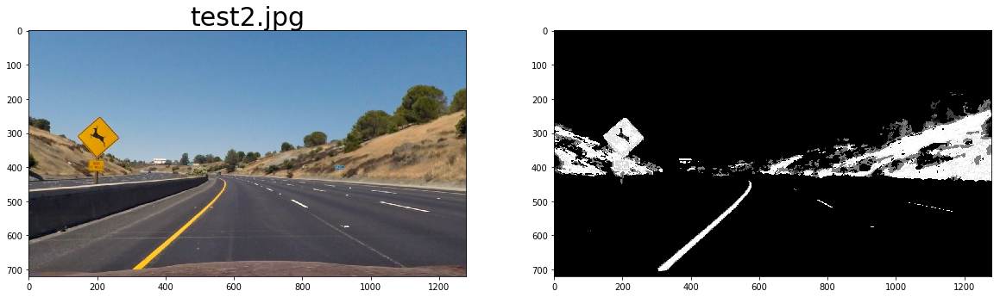

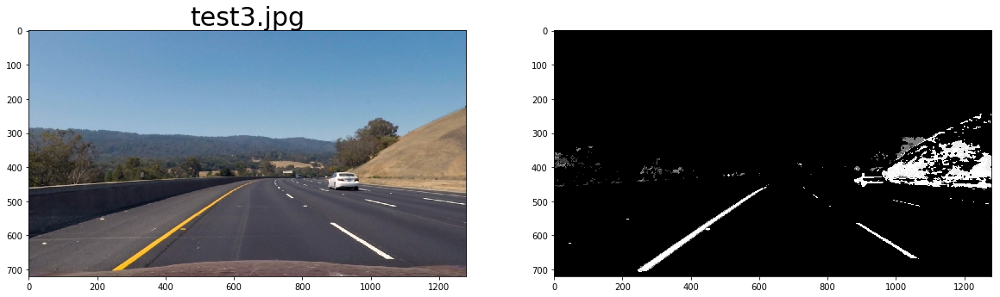

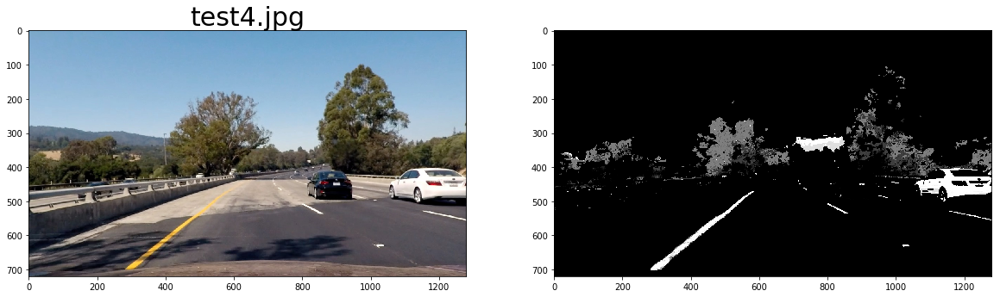

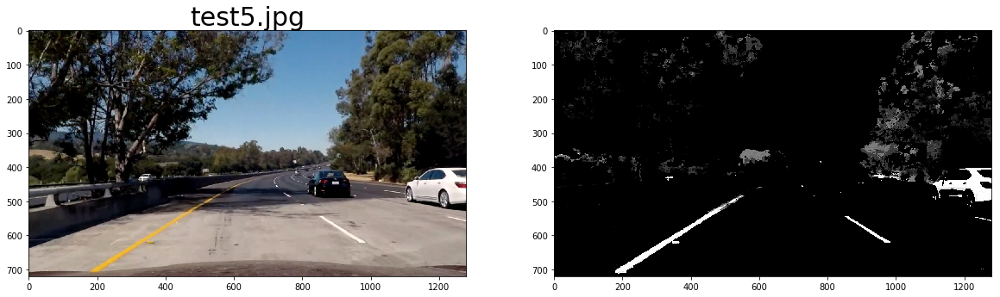

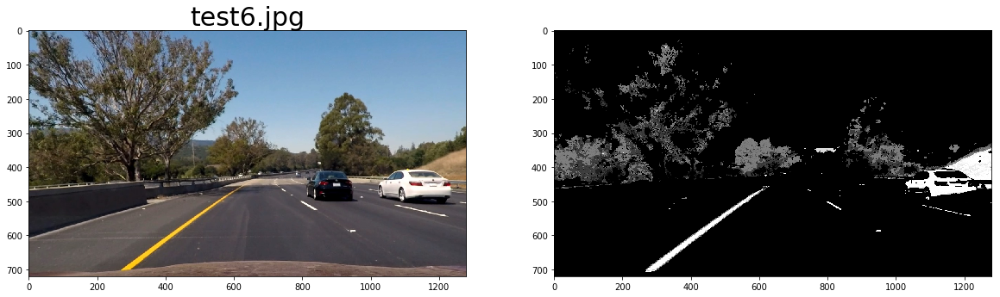

In [10]:
for f in os.listdir(path_prefix):
    filename=path_prefix+f
    image1=read_image(filename)
    image2=calc_thresholds(filename=filename)
    print_2images(image1,image2,title1=f)

## Perspective Transform

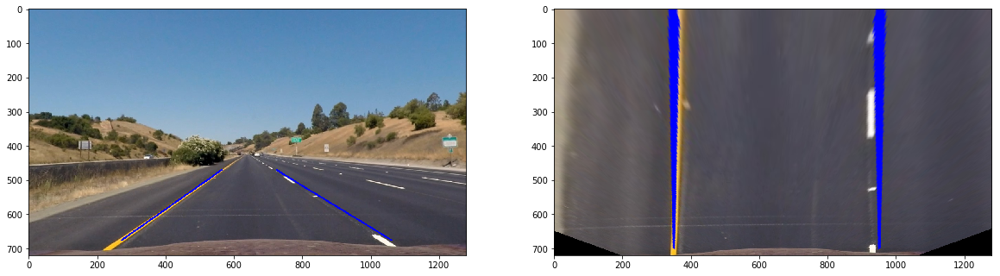

In [11]:
def draw_lines(img,lines,color=[0,0,255],thickness=3):
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img,(int(x1),int(y1)),(int(x2),int(y2)),color,thickness)
    return img      

filename=path_prefix+"straight_lines1.jpg"
image1=read_image(filename)
src=np.float32([[272,675],[1060,675],[723,470],[564,470]])
dst=np.float32([[350,700],[950,700],[950,0],[350,0]])
a=draw_lines(image1,[[[272,675,564,470]],[[723,470,1060,675]]])
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
img_size=(1280,720)
warped = cv2.warpPerspective(a, M, img_size, flags=cv2.INTER_LINEAR)
print_2images(a,warped)
camera_perspective_transform={}
camera_perspective_transform["M"]=M
camera_perspective_transform["Minv"]=Minv
pickle.dump(camera_perspective_transform,open("perspective_transform.p","wb"))
def do_perspective_transform(image,inverse='f'):
    cam=pickle.load(open("perspective_transform.p","rb"))   
    M=cam["M"]
    Minv=cam["Minv"]
    img_size=(image.shape[1],image1.shape[0])
    if inverse=='f':
        warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_LINEAR)
    else:
        warped = cv2.warpPerspective(image, Minv, img_size, flags=cv2.INTER_LINEAR)
    return warped

/Volumes/work/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:25: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


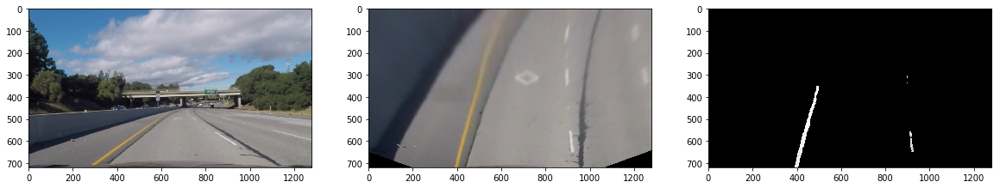

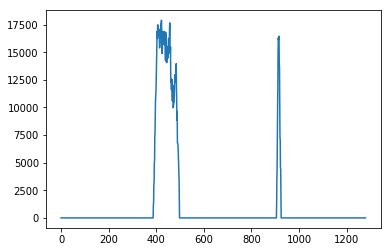

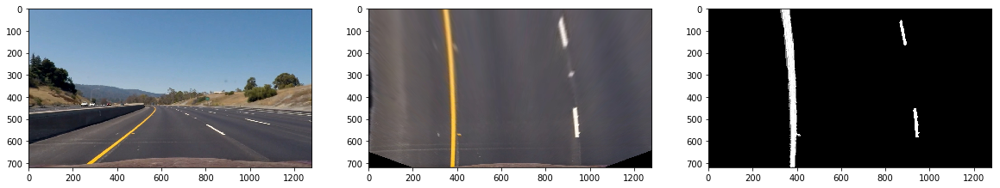

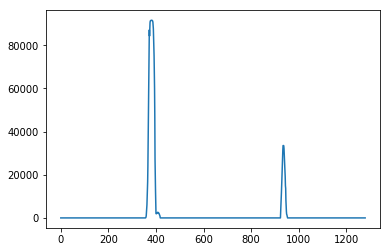

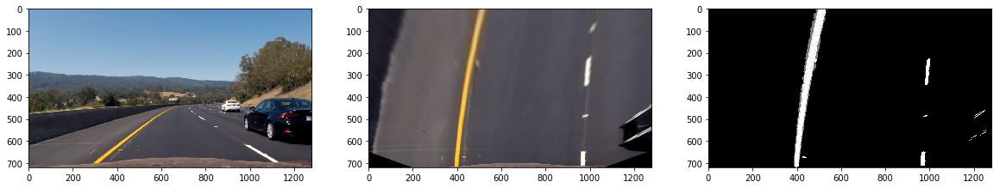

...

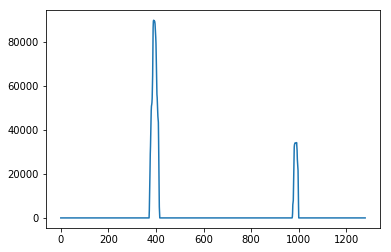

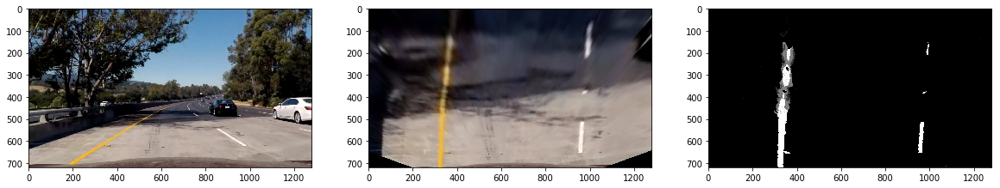

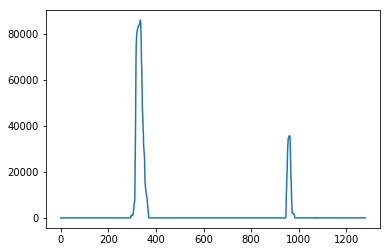

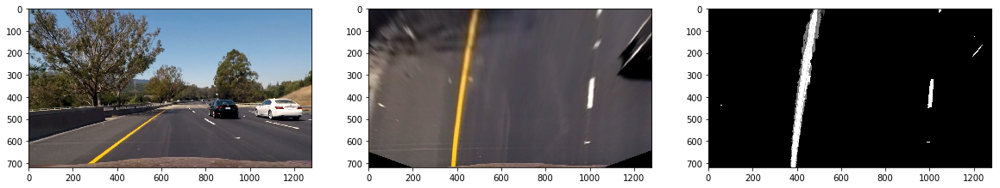

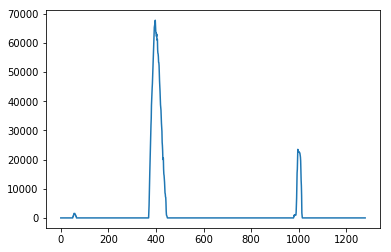

In [12]:
for f in os.listdir(path_prefix):
    filename=path_prefix+f
    image1=read_image(filename)
    warped = do_perspective_transform(image1)
    binary_warped=calc_thresholds(image=warped)
    print_3images(image1,warped,binary_warped)
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    plt.plot(histogram)
    plt.show()

### Calculate radius of curvature and vehicle position

In [13]:
#To find the radius of curvature ,I use the 3 point circle equation.
# the 3 points I choose are the lane mid points for y =0,y=360 and y=720
def radius_of_curvature(left_fit,right_fit):
    #generate data points for all  Y values from the polynomial equation,use that to get polynomial equation in meters
    #Dont necessarily need all 720 
    ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
    leftx=[]
    rightx=[]
    for i in ploty:
        leftx.append(np.polyval(left_fit,i))
        rightx.append(np.polyval(right_fit,i))
  
    my = 3/140 # meters per pixel in y dimension
    mx = 3.7/600 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    y_eval=720*my#bottom of the frame in meters
    lefty=ploty
    righty=ploty
    leftx=np.array(leftx)
    rightx=np.array(rightx)
    left_fit_cr = np.polyfit(lefty*my, leftx*mx, 2)
    right_fit_cr = np.polyfit(righty*my, rightx*mx, 2)
    # Calculate the new radii of curvature
    left_x_bottom=np.polyval(left_fit_cr,720*my)
    right_x_bottom=np.polyval(right_fit_cr,720*my)
    left_x_middle=np.polyval(left_fit_cr,360*my)
    right_x_middle=np.polyval(right_fit_cr,360*my)
    left_x_top=np.polyval(left_fit_cr,0*my)
    right_x_top=np.polyval(right_fit_cr,0*my)
    
    x1=(left_x_top+right_x_top)/2
    x2=(left_x_middle+right_x_middle)/2
    x3=(left_x_bottom+right_x_bottom)/2
    X=np.array([x1,x2,x3])
    Y=np.array([0,360,720])*my
    m1=(Y[1]-Y[0])/(X[1]-X[0])
    m2=(Y[2]-Y[1])/(X[2]-X[1])
    
    x_center=(m1*m2*(Y[0]-Y[2])+m2*(X[0]+X[1])-m1*(X[1]+X[2]))/(2*(m2-m1))
    y_center=(x_center-(X[0]+X[1])/2)/-m1 +(Y[0]+Y[1])/2
    radius=((x_center-X[0])**2+(y_center-Y[0])**2)**0.5
    pos=(x3-(640*mx))

    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    #print (left_curverad,right_curverad)
    return radius,pos

## Identifying lane lines

In [14]:
need_sliding_window=1
left_fit=[]
right_fit=[]
show_images=1
def pipeline(binary_warped):
    global show_images,need_sliding_window,left_fit,right_fit
    if (need_sliding_window==1):
        # To visualize the pipeline 
        out_img=np.array(binary_warped,copy=True)
        # Assuming you have created a warped binary image called "binary_warped"
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        
        ###My way is to find the left most and then search about 700 pixels starting 200 pixels to its right.
        ###I start from 200 to the right to avoid finding the left lane again.
        leftx_base = np.argmax(histogram[0:midpoint])
        rightx_base = np.argmax(histogram[leftx_base+200:leftx_base+700])+leftx_base+200
        # Choose the number of sliding windows
        nwindows = 9
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
            (255,255,255), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
            (255,255,255), 2) 
            if (show_images==1):
                plt.imshow(out_img,cmap='gray')
                plt.show()
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        if (len(leftx)!=0):
            left_fit = np.polyfit(lefty, leftx, 2)
        if (len(rightx)!=0):
            right_fit = np.polyfit(righty, rightx, 2)
        #once we find the curve ,we dont need sliding window
        need_sliding_window=0
    else:
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        margin = 100
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
            left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
            left_fit[1]*nonzeroy + left_fit[2] + margin))) 

        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
            right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
            right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # Again, extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        # Fit a second order polynomial to each
        #in the else
        if (len(leftx)!=0):
            left_fit = np.polyfit(lefty, leftx, 2)
        if (len(rightx!=0)):
            right_fit = np.polyfit(righty, rightx, 2)    
    
    
    radius,pos=radius_of_curvature(left_fit,right_fit)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (255,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (255,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='red')
    plt.plot(right_fitx, ploty, color='red')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    plt.imshow(binary_warped,cmap='gray')
    plt.plot(left_fitx, ploty, color='green')
    plt.plot(right_fitx, ploty, color='green')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    if show_images==1:
        plt.title("Lane lines identified",fontsize=30)
        plt.show()
    
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (color_warp.shape[1], color_warp.shape[0])) 
    newwarp = do_perspective_transform(color_warp,inverse='t')
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(newwarp,'Radius= %.3f meters'%(radius),(50,50), font, 1,(255,0,255),2)
    if (pos>0):
        txt="left of center"
    else:
        txt="right of center"
    cv2.putText(newwarp,'Position= %.3f meters %s '%(np.abs(pos),txt),(50,80), font, 1,(255,0,255),2)  
    if show_images==1:
        print_2images(result,color_warp)
        print_2images(color_warp,newwarp)
    return newwarp


In [15]:
def process_image(orig_image):
    undistorted_image=undistort(orig_image)
    warped = do_perspective_transform(undistorted_image)
    binary_warped=calc_thresholds(image=warped)
    newwarp=pipeline(binary_warped)
    # Combine the result with the undistorted_image image
    result = cv2.addWeighted(undistorted_image, 1, newwarp, 0.3, 0)
    return result

## Initialize variables before running through the pipeline.
def init(show_images_val=1):
    global show_images,need_sliding_window,left_fit,right_fit
    need_sliding_window=1
    left_fit=[]
    right_fit=[]
    show_images=show_images_val

## Visualize the lane finding pipeline with sliding window

/Volumes/work/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:25: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


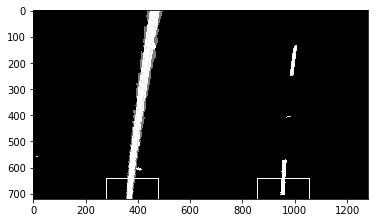

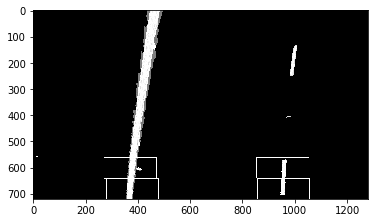

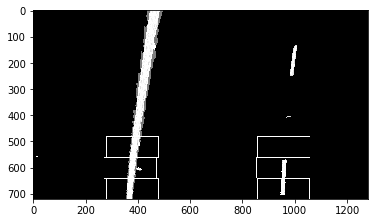

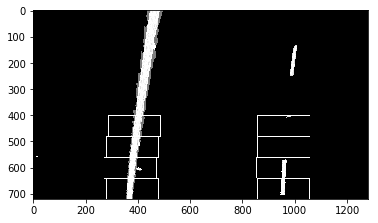

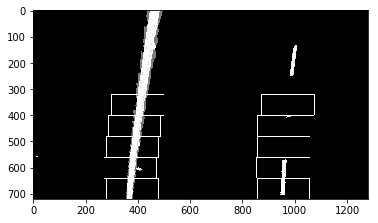

...

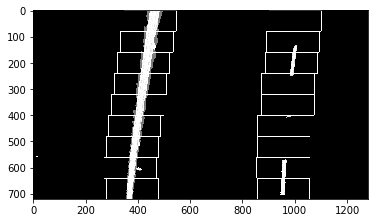

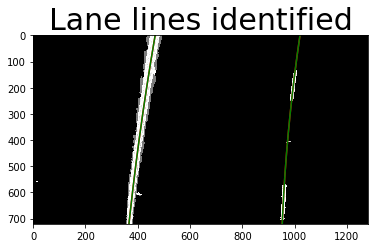

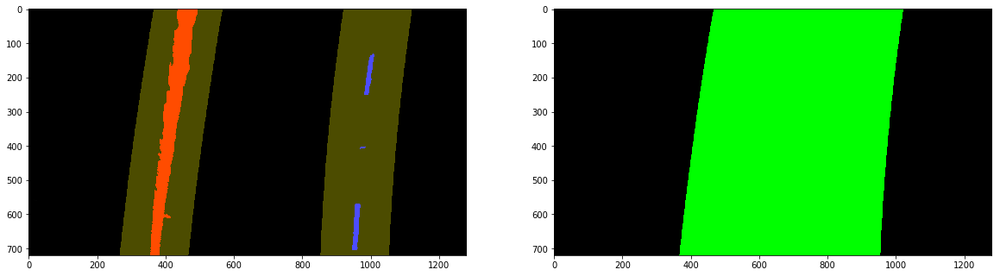

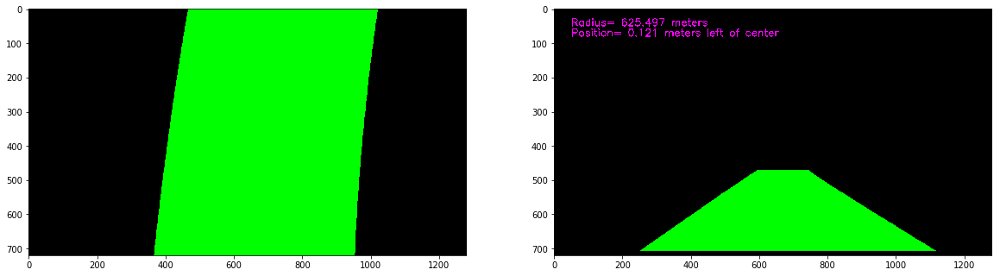

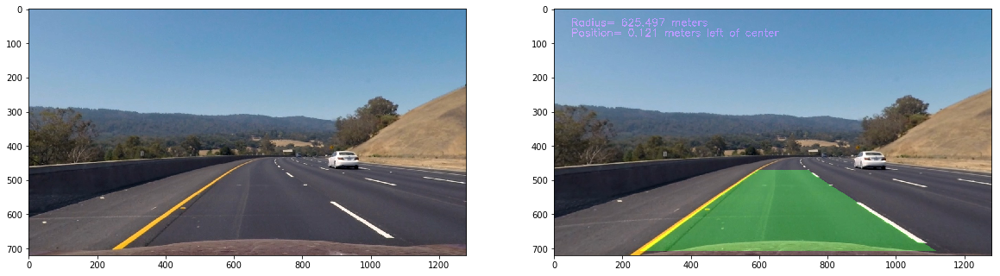

In [16]:
filename="test_images/test3.jpg"
image=plt.imread(filename)
image1=read_image(filename)
init(show_images_val=1)
image2=process_image(image1)
print_2images(image1,image2)

/Volumes/work/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:25: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


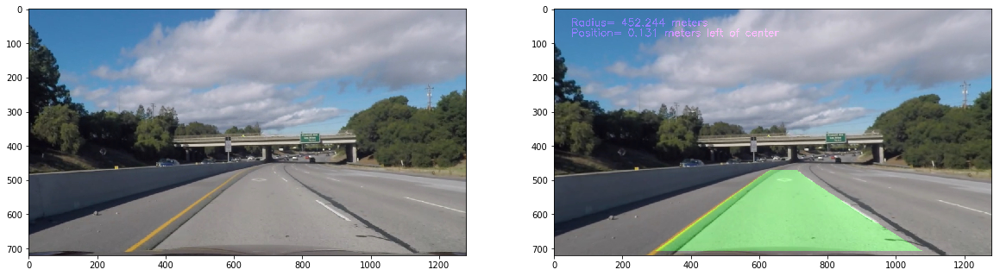

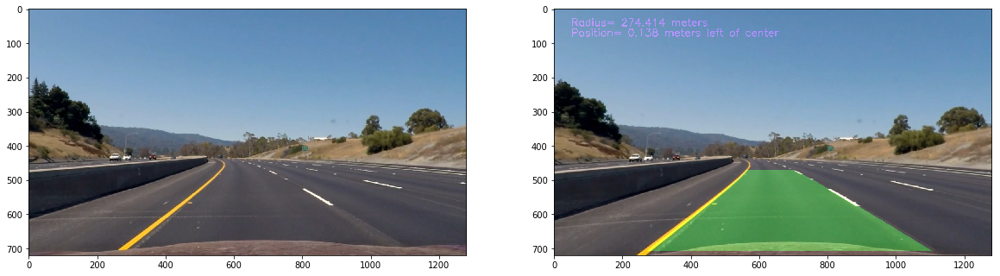

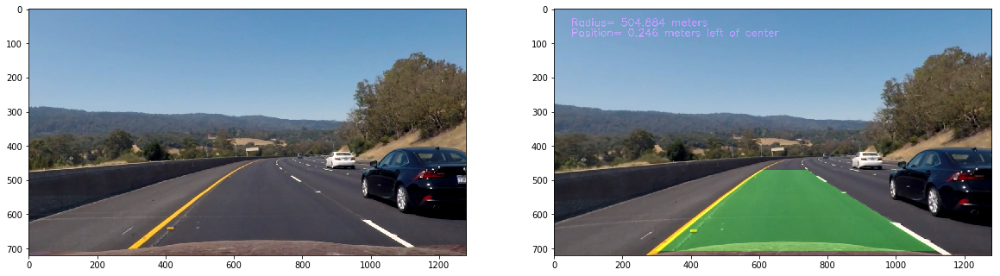

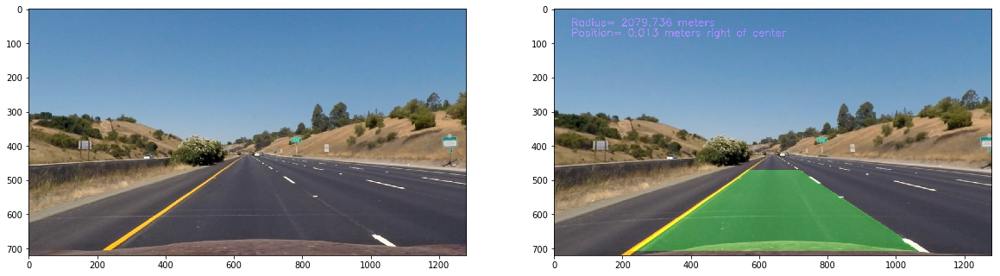

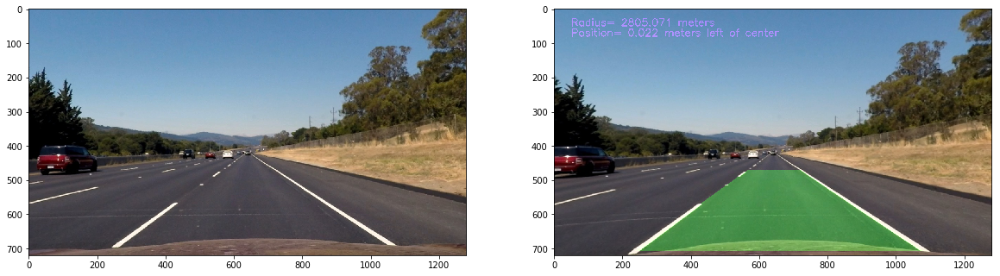

...

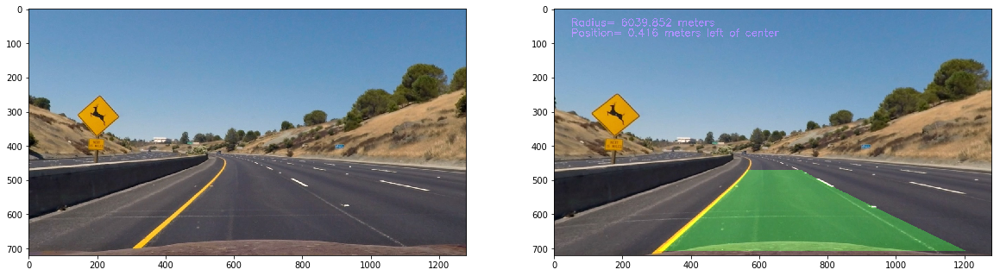

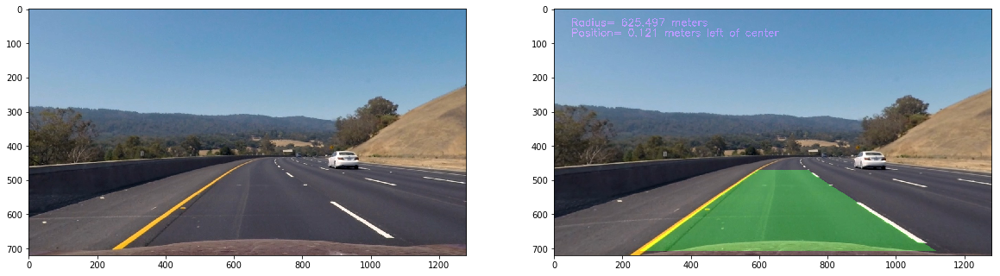

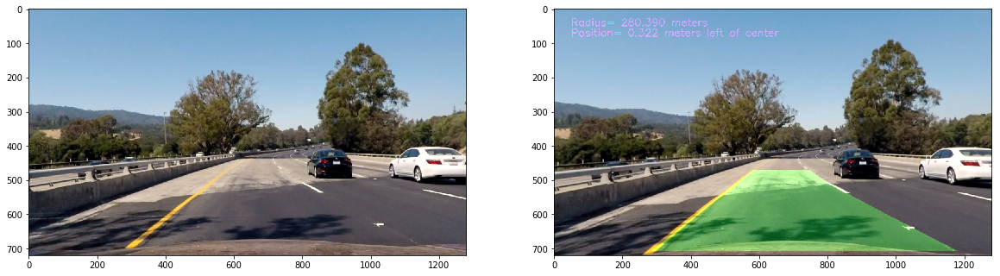

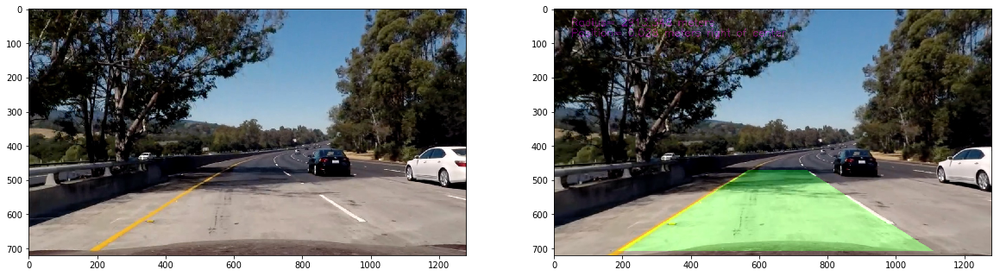

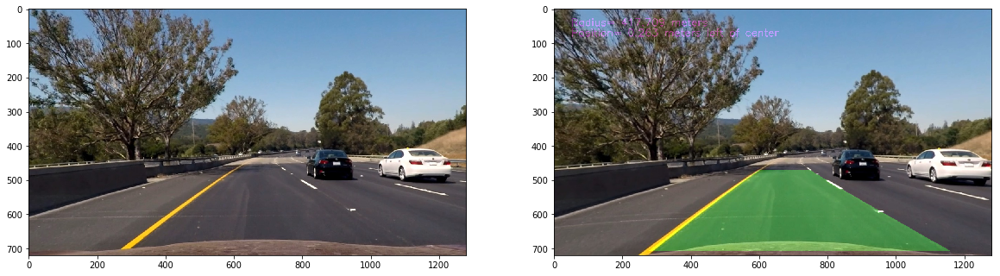

In [17]:
for f in os.listdir(path_prefix):
    filename=path_prefix+f
    image1=read_image(filename)
    init(show_images_val=0)
    image2=process_image(image1)
    print_2images(image1,image2)

In [18]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

[MoviePy] >>>> Building video output_project_video.mp4
[MoviePy] Writing video output_project_video.mp4


100%|█████████▉| 1260/1261 [06:52<00:00,  2.17it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_project_video.mp4 

CPU times: user 8min 33s, sys: 33.7 s, total: 9min 6s
Wall time: 6min 53s


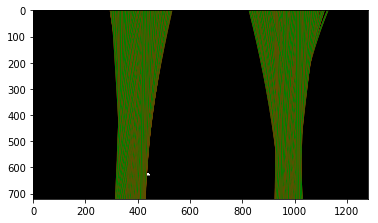

In [19]:
video = 'output_project_video.mp4'
clip1 = VideoFileClip("project_video.mp4")
init(show_images_val=0)
clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip.write_videofile(video, audio=False)


In [23]:
HTML("""
<video width="def_image_width" height="def_image_height" controls>
  <source src="{0}">
</video>
""".format(video))